<a href="https://colab.research.google.com/github/sumitgargesh/DEMON-D/blob/main/demon_d_BVBRC_genome_amr.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install umap-learn biopython transformers torch

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.3/3.3 MB 90.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 113.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 76.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 54.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 843.6 kB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 4.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 13.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 8.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 6.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 96.7 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstallin

### **Data Preprocessing**:
*   Download sequences in FASTA format
*   Filter to get 200-500 sequences with binary labels (e.g., resistant vs. non-resistant)
*   Clean sequences (remove ambiguous nucleotides, standardize length if necessary)
*   Split data into classes based on labels

In [ ]:
def normalize_id(id_str):
    if '.' in id_str:
        left, right = id_str.split('.')
        return f"{left}.{right.ljust(5, '0')}"
    return id_str

In [ ]:
from Bio import SeqIO
import pandas as pd
import numpy as np


# Step 1: Parse FASTA file and collect sequences with their IDs
fasta_records = []
for record in SeqIO.parse("pbp4.fasta", "fasta"):
    fasta_records.append({
        'id': record.id,  # Extracts the unique ID like 1280.113
        'sequence': str(record.seq)
    })

fasta_df = pd.DataFrame(fasta_records)

fasta_df['id'] = fasta_df['id'].astype(str).apply(normalize_id)

print("Shape of fasta_df: ", fasta_df.shape)

# Step 2: Load labels file (Two columns: id and label)
labels_df = pd.read_csv("labels.txt", sep='\t', engine='python', header=None, names=['id', 'label'])
labels_df['id'] = labels_df['id'].astype(str).apply(normalize_id)

print("Shape of labels_df: ", labels_df.shape)

# # --- Added for debugging ---
# print("First 5 IDs in fasta_df:")
# print(fasta_df['id'].head())
# print("\nFirst 5 IDs in labels_df:")
# print(labels_df['id'].head())
# print("-" * 20)
# # --- End of debugging additions ---

# Step 3: Merge the sequences with labels on ID
merged_df = pd.merge(fasta_df, labels_df, on='id')

# --- Added for debugging ---
print(f"Number of rows in merged_df after initial merge: {len(merged_df)}")
# --- End of debugging additions ---

# print("Shape after merging: ", merged_df.shape)

# Step 4: Remove sequences with ambiguous nucleotides
merged_df['sequence'] = merged_df['sequence'].str.upper()
merged_df = merged_df[~merged_df['sequence'].str.contains('[^ATGC]')]

# print("Shape after merging: ", merged_df.shape)

merged_df.to_csv('processed_sequences.csv', index=False)

# # Step 5: Balance the classes if needed
# min_class_size = min(merged_df['label'].value_counts())
# data_bal = pd.concat([
#     merged_df[merged_df['label'] == 0].sample(min_class_size, random_state=42),
#     merged_df[merged_df['label'] == 1].sample(min_class_size, random_state=42)
# ])

# # Step 6: Save processed data
# data_bal.to_csv('processed_sequences.csv', index=False)

Shape of fasta_df:  (135, 2)
Shape of labels_df:  (135, 2)
Number of rows in merged_df after initial merge: 135


In [ ]:
data_bal.shape
min_class_size = min(data_bal['label'].value_counts())
data_bal['label'].value_counts()

merged_df.shape
min_class_size = min(merged_df['label'].value_counts())
merged_df['label'].value_counts()

,count
label,
1,98
0,37


### **Generate DNABERT Embeddings**

In [ ]:
import torch
from transformers import AutoTokenizer, AutoModel
import numpy as np
import pandas as pd

# Load tokenizer and model
model_name = "zhihan1996/DNA_bert_6"  # For 6-mer DNABERT
tokenizer = AutoTokenizer.from_pretrained(model_name)
model = AutoModel.from_pretrained(model_name)

# Function to convert DNA sequence to k-mers
def seq_to_kmers(seq, k=6):
    kmers = []
    for i in range(len(seq) - k + 1):
        kmers.append(seq[i:i+k])
    return " ".join(kmers)

# Load your sequences
data = pd.read_csv('processed_sequences.csv')

# Convert to k-mers and generate embeddings
embeddings = []
labels = []

for idx, row in data.iterrows():
    seq = row['sequence']
    label = row['label']

    # Convert to k-mers
    kmer_seq = seq_to_kmers(seq)

    # Tokenize and get embeddings
    inputs = tokenizer(kmer_seq, return_tensors="pt", truncation=True, max_length=512)

    with torch.no_grad():
        outputs = model(**inputs)

    # Get CLS token embedding (first token)
    cls_embedding = outputs.last_hidden_state[:, 0, :].numpy().flatten()

    embeddings.append(cls_embedding)
    labels.append(label)

# Save embeddings
embedding_df = pd.DataFrame(embeddings)
embedding_df['label'] = labels
embedding_df.to_csv('dnabert_embeddings.csv', index=False)

### **Dimensionality Reduction and Visualization**

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/manifold/_spectral_embedding.py:329: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn(


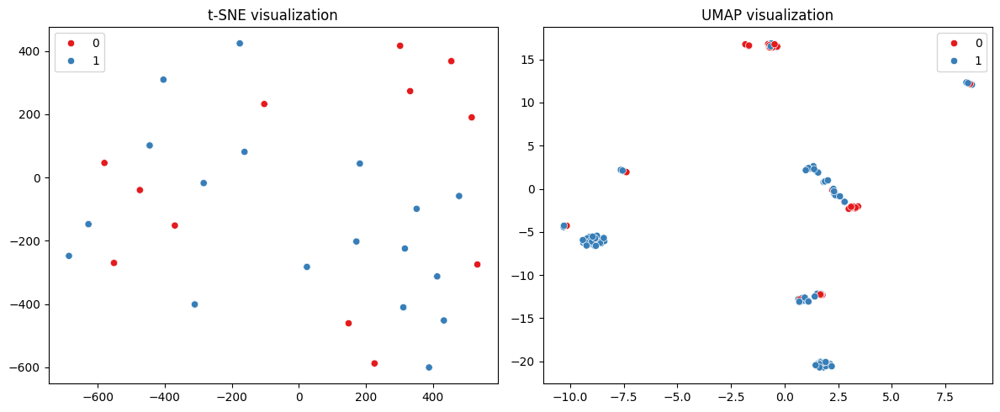

In [ ]:
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
import umap
import matplotlib.pyplot as plt
import seaborn as sns

# Load embeddings
embedding_df = pd.read_csv('dnabert_embeddings.csv')
X = embedding_df.drop('label', axis=1).values
y = embedding_df['label'].values

# PCA for initial dimensionality reduction
pca = PCA(n_components=50)
X_pca = pca.fit_transform(X)

pca_df = pd.DataFrame(X_pca)
pca_df.columns = [f'PC{i+1}' for i in range(pca_df.shape[1])]
pca_df.to_csv('pca_embeddings.csv', index=False)

# t-SNE for visualization
tsne = TSNE(n_components=2, random_state=42)
X_tsne = tsne.fit_transform(X_pca)

# UMAP for visualization (alternative)
reducer = umap.UMAP(random_state=42)
X_umap = reducer.fit_transform(X_pca)

umap_df = pd.DataFrame(X_umap)
# umap_df.columns = [f'PC{i+1}' for i in range(pca_df.shape[1])]
umap_df.to_csv('umap_embeddings.csv', index=False)

# Visualize
plt.figure(figsize=(12, 5))

# t-SNE plot
plt.subplot(1, 2, 1)
sns.scatterplot(x=X_tsne[:, 0], y=X_tsne[:, 1], hue=y, palette='Set1')
plt.title('t-SNE visualization')

# UMAP plot
plt.subplot(1, 2, 2)
sns.scatterplot(x=X_umap[:, 0], y=X_umap[:, 1], hue=y, palette='Set1')
plt.title('UMAP visualization')

plt.tight_layout()
plt.savefig('embedding_visualization.png')
plt.show()

### **Outlier Detection**

/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_lof.py:322: UserWarning: Duplicate values are leading to incorrect results. Increase the number of neighbors for more accurate results.
  warnings.warn(


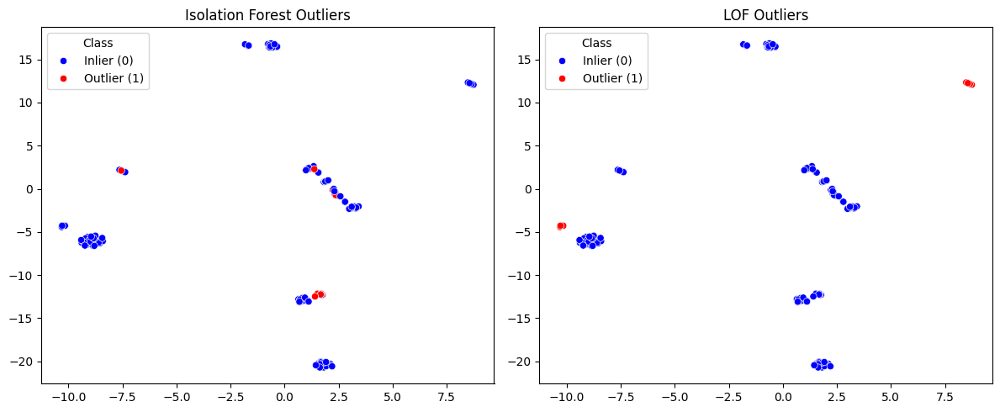

In [ ]:
from sklearn.ensemble import IsolationForest
from sklearn.neighbors import LocalOutlierFactor
import numpy as np
import matplotlib.pyplot as plt

# Load dimensionality-reduced embeddings
X_pca = pd.read_csv('pca_embeddings.csv').values
labels = pd.read_csv('dnabert_embeddings.csv')['label'].values

# Apply Isolation Forest
iso_forest = IsolationForest(contamination=0.10, random_state=42)
outliers_if = iso_forest.fit_predict(X_pca)
# Convert to binary (1: inlier, -1: outlier)
outliers_if = [1 if x == -1 else 0 for x in outliers_if]

# Apply Local Outlier Factor
lof = LocalOutlierFactor(n_neighbors=20, contamination=0.10)
outliers_lof = lof.fit_predict(X_pca)
# Convert to binary (1: inlier, -1: outlier)
outliers_lof = [1 if x == -1 else 0 for x in outliers_lof]

# Create DataFrame with results
results = pd.DataFrame({
    'sequence_id': range(len(X_pca)),
    'true_label': labels,
    'isolation_forest_outlier': outliers_if,
    'lof_outlier': outliers_lof,
    'consensus_outlier': [1 if a + b > 0 else 0 for a, b in zip(outliers_if, outliers_lof)]
})

# Save results
results.to_csv('outlier_detection_results.csv', index=False)

# Visualize outliers on UMAP projection
X_umap = pd.read_csv('umap_embeddings.csv').values

plt.figure(figsize=(12, 5))

# Plot by Isolation Forest
plt.subplot(1, 2, 1)
scatter_iso = sns.scatterplot(
    x=X_umap[:, 0],
    y=X_umap[:, 1],
    hue=outliers_if,
    palette={0: 'blue', 1: 'red'}
)
plt.title('Isolation Forest Outliers')
handles, _ = scatter_iso.get_legend_handles_labels()
plt.legend(handles=handles, labels=['Inlier (0)', 'Outlier (1)'], title='Class')


# Plot by LOF
plt.subplot(1, 2, 2)
scatter_lof = sns.scatterplot(x=X_umap[:, 0], y=X_umap[:, 1], hue=outliers_lof, palette={0: 'blue', 1: 'red'})
plt.title('LOF Outliers')
handles, _ = scatter_lof.get_legend_handles_labels()
plt.legend(handles=handles, labels=['Inlier (0)', 'Outlier (1)'], title='Class')


plt.tight_layout()
plt.savefig('outlier_visualization.png')
plt.show()

### **Evaluation and Analysis**

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report, accuracy_score
from Bio import Entrez, SeqIO
from io import StringIO

# Load data
results = pd.read_csv('outlier_detection_results.csv')
X_pca = pd.read_csv('pca_embeddings.csv').values
labels = results['true_label'].values
outliers = results['consensus_outlier'].values

# Evaluate impact on classification
# Create datasets with and without outliers
X_with_outliers = X_pca
y_with_outliers = labels

X_without_outliers = X_pca[outliers == 0]
y_without_outliers = labels[outliers == 0]

# Train-test split
X_train_with, X_test_with, y_train_with, y_test_with = train_test_split(
    X_with_outliers, y_with_outliers, test_size=0.3, random_state=42)

X_train_without, X_test_without, y_train_without, y_test_without = train_test_split(
    X_without_outliers, y_without_outliers, test_size=0.3, random_state=42)

# Train classifiers
clf_with = LogisticRegression(random_state=42).fit(X_train_with, y_train_with)
clf_without = LogisticRegression(random_state=42).fit(X_train_without, y_train_without)

# Evaluate
y_pred_with = clf_with.predict(X_test_with)
y_pred_without = clf_without.predict(X_test_without)

# Print results
print("Classification with outliers:")
print(classification_report(y_test_with, y_pred_with))
print("Accuracy:", accuracy_score(y_test_with, y_pred_with))

print("\nClassification without outliers:")
print(classification_report(y_test_without, y_pred_without))
print("Accuracy:", accuracy_score(y_test_without, y_pred_without))

# Optional: BLAST validation for a few outliers
# This is a simplified example - would need to be expanded
def blast_sequence(seq):
    Entrez.email = "your_email@example.com"  # Set your email

    # Run BLAST
    result_handle = NCBI.qblast("blastn", "nt", seq)
    blast_results = result_handle.read()
    return blast_results

# Analyze a few outliers if original sequences are available
original_sequences = pd.read_csv('processed_sequences.csv')['sequence'].values
outlier_indices = np.where(outliers == 1)[0]

for idx in outlier_indices[:5]:  # First 5 outliers
    seq = original_sequences[idx]
    true_label = labels[idx]
    print(f"Outlier {idx}, True label: {true_label}")
    print(f"Sequence length: {len(seq)}")
    # Uncomment to run BLAST (takes time)
    # blast_result = blast_sequence(seq)
    # print("BLAST top hit:", blast_result)
    print("-" * 50)

Classification with outliers:
              precision    recall  f1-score   support

           0       0.90      0.82      0.86        11
           1       0.94      0.97      0.95        30

    accuracy                           0.93        41
   macro avg       0.92      0.89      0.90        41
weighted avg       0.93      0.93      0.93        41

Accuracy: 0.926829268292683

Classification without outliers:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86        10
           1       0.95      0.91      0.93        23

    accuracy                           0.91        33
   macro avg       0.89      0.91      0.90        33
weighted avg       0.91      0.91      0.91        33

Accuracy: 0.9090909090909091
Outlier 1, True label: 0
Sequence length: 1296
--------------------------------------------------
Outlier 5, True label: 0
Sequence length: 1296
--------------------------------------------------
Outlier 7, True label: 1
Sequ

# *FASTA sequences* from CARD (e.g., AMR genes)

## Parse DNA Sequences and Extract ARO IDs


In [2]:
import pandas as pd


BVBRC_genome_amr_df = pd.read_csv("BVBRC_genome_amr.csv")

In [86]:
BVBRC_genome_amr_df.head()

,Taxon ID,Genome ID,Genome Name,Antibiotic,Resistant Phenotype,Measurement,Measurement Sign,Measurement Value,Measurement Unit,Laboratory Typing Method,...,Laboratory Typing Platform,Vendor,Testing Standard,Testing Standard Year,Computational Method,Computational Method Version,Computational Method Performance,Evidence,Source,PubMed
0,1280,1280.30015,Staphylococcus aureus strain HICF0446,cefoxitin,Resistant,NaN,NaN,NaN,NaN,Disk diffusion,...,NaN,NaN,EUCAST,2019.0,NaN,NaN,NaN,Laboratory Method,NaN,32025709.0
1,1280,1280.51921,Staphylococcus aureus 14-01017,cefoxitin,Susceptible,NaN,NaN,NaN,NaN,Broth dilution,...,NaN,NaN,EUCAST,2018.0,NaN,NaN,NaN,Laboratory Method,NaN,33658988.0
2,1280,1280.29789,Staphylococcus aureus strain HICF0145,cefoxitin,Resistant,NaN,NaN,NaN,NaN,Disk diffusion,...,NaN,NaN,EUCAST,2019.0,NaN,NaN,NaN,Laboratory Method,NaN,32025709.0
3,1280,1280.16570,Staphylococcus aureus strain AR_0220,cefoxitin,Resistant,>16,>,16.0,mg/L,Broth dilution,...,NaN,NaN,CLSI,NaN,NaN,NaN,NaN,Laboratory Method,NaN,NaN
4,1280,1280.29822,Staphylococcus aureus strain HICF0184,cefoxitin,Resistant,NaN,NaN,NaN,NaN,Disk diffusion,...,NaN,NaN,EUCAST,2019.0,NaN,NaN,NaN,Laboratory Method,NaN,32025709.0


In [3]:
genome_id_list = BVBRC_genome_amr_df['Genome ID']
genome_id_list

,Genome ID
0,1280.30015
1,1280.51921
2,1280.29789
3,1280.16570
4,1280.29822
...,...
1527,1280.29735
1528,1280.30272
1529,1280.51903
1530,1280.29922


In [4]:
import requests
from tqdm import tqdm
records = []

for id in tqdm(genome_id_list):
  genome_id = id  # Example genome ID from BV-BRC
  url = f"https://www.bv-brc.org/api/genome_sequence/?eq(genome_id,{genome_id})"

  # BV-BRC requires JSON Accept header
  headers = {"Accept": "application/dna+fasta"}

  response = requests.get(url, headers=headers)

  if response.ok:
    genome_sequence = response.text
    status = "Success"
  else:
    genome_sequence = None
    status = "Failed"

  records.append({
      "Genome_Id": genome_id,
      "Fasta_Data": genome_sequence,
      "Status": status
  })

genomes_df = pd.DataFrame(records)

print(genomes_df.head)

100%|██████████| 1532/1532 [55:42<00:00,  2.18s/it]

<bound method NDFrame.head of        Genome_Id                                         Fasta_Data   Status
0     1280.30015  >accn|1280.30015.con.0065   ERR3826288_contig_...  Success
1     1280.51921  >accn|1280.51921.con.0012   ERR4899927_contig_...  Success
2     1280.29789  >accn|1280.29789.con.0025   ERR3826817_contig_...  Success
3     1280.16570                                                     Success
4     1280.29822  >accn|1280.29822.con.0017   ERR3826840_contig_...  Success
...          ...                                                ...      ...
1527  1280.29735  >accn|1280.29735.con.0012   ERR3826761_contig_...  Success
1528  1280.30272  >accn|1280.30272.con.0039   ERR3826542_contig_...  Success
1529  1280.51903  >accn|1280.51903.con.0016   ERR4899991_contig_...  Success
1530  1280.29922  >accn|1280.29922.con.0016   ERR3826179_contig_...  Success
1531  1280.11351  >accn|FQDL01000017   Staphylococcus aureus str...  Success

[1532 rows x 3 columns]>


In [7]:
genomes_df.to_csv("/content/drive/MyDrive/Colab Notebooks/DEMON-D/genomes_df.csv", index='False')

In [6]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [8]:
genomes_df.head()

,Genome_Id,Fasta_Data,Status
0,1280.30015,>accn|1280.30015.con.0065 ERR3826288_contig_...,Success
1,1280.51921,>accn|1280.51921.con.0012 ERR4899927_contig_...,Success
2,1280.29789,>accn|1280.29789.con.0025 ERR3826817_contig_...,Success
3,1280.16570,,Success
4,1280.29822,>accn|1280.29822.con.0017 ERR3826840_contig_...,Success


In [42]:
genomes_filtered_df = genomes_df[genomes_df['Fasta_Data'] != ''].reset_index(drop=True)

In [43]:
genomes_filtered_df.head()

,Genome_Id,Fasta_Data,Status
0,1280.30015,>accn|1280.30015.con.0065 ERR3826288_contig_...,Success
1,1280.51921,>accn|1280.51921.con.0012 ERR4899927_contig_...,Success
2,1280.29789,>accn|1280.29789.con.0025 ERR3826817_contig_...,Success
3,1280.29822,>accn|1280.29822.con.0017 ERR3826840_contig_...,Success
4,1280.11261,>accn|FQHI01000002 Staphylococcus aureus str...,Success


In [47]:
!pip install umap-learn biopython

In [80]:
from Bio import SeqIO
import pandas as pd
from tqdm import tqdm
from io import StringIO
import re

concat_seqs = []
genome_ids = []
for i,row in tqdm(genomes_filtered_df.iterrows()):
  fasta_data = genomes_filtered_df.iloc[i]['Fasta_Data']
  genome_id = genomes_filtered_df.iloc[i]['Genome_Id']

  # Wrap the string as a file-like object
  fasta_io = StringIO(fasta_data)

  sequences = []

  for record in SeqIO.parse(fasta_io, "fasta"):
      seq = str(record.seq)
      description = record.description
      sequences.append(seq)

  fasta_df = pd.DataFrame({
      "Genome_ID": genome_id,
      "sequence": sequences
  })

  #~~ Concatinating all the sequences
  concatenated_seq = ""
  for _, row in fasta_df.iterrows():
    concatenated_seq += row.sequence

  genome_ids.append(genome_id)
  concat_seqs.append(concatenated_seq)

all_seq_df = pd.DataFrame({
    "Genome_ID": genome_ids,
    "Concatenated_Sequences": concat_seqs
})


1394it [01:15, 18.52it/s]


In [83]:
all_seq_df.head()

,Genome_ID,Concatenated_Sequences
0,1280.30015,attgtgtatgtattgcatccatatgattggaataaatatgtgcatc...
1,1280.51921,ttcttgcttatttagttaattcaaagtgcacgccggattcattaga...
2,1280.29789,aaaaattagccgaaaaacatcatttctgaagttatcggctaaagtt...
3,1280.29822,atcaaagaagtgttactttataattaatgtttttattagagcgtct...
4,1280.11261,gctctatctctagagttgtcaaaggatgtcaagatttggtaaggtt...


In [84]:
#~~ Saving all-seq-df
all_seq_df.to_csv("/content/drive/MyDrive/Colab Notebooks/DEMON-D/all_concatenated_seq.csv", index=False)

In [92]:
BVBRC_genome_amr_filtered_df = BVBRC_genome_amr_df[['Genome ID','Resistant Phenotype']].reset_index(drop=True)
BVBRC_genome_amr_filtered_df.head()

,Genome ID,Resistant Phenotype
0,1280.30015,Resistant
1,1280.51921,Susceptible
2,1280.29789,Resistant
3,1280.16570,Resistant
4,1280.29822,Resistant


In [95]:
resistant_label = [1 if item['Resistant Phenotype'] == 'Resistant' else 0 for _,item in BVBRC_genome_amr_filtered_df.iterrows()]
BVBRC_genome_amr_filtered_df['Resistant_Label'] = resistant_label
BVBRC_genome_amr_filtered_df.head()

,Genome ID,Resistant Phenotype,Resistant_Label
0,1280.30015,Resistant,1
1,1280.51921,Susceptible,0
2,1280.29789,Resistant,1
3,1280.16570,Resistant,1
4,1280.29822,Resistant,1


In [97]:
genome_labeled_df = pd.merge(all_seq_df, BVBRC_genome_amr_filtered_df,
                             left_on='Genome_ID', right_on='Genome ID',
                             how='inner')
genome_labeled_df = genome_labeled_df[['Genome_ID','Concatenated_Sequences','Resistant Phenotype','Resistant_Label']]
genome_labeled_df.head()

,Genome_ID,Concatenated_Sequences,Resistant Phenotype,Resistant_Label
0,1280.30015,attgtgtatgtattgcatccatatgattggaataaatatgtgcatc...,Resistant,1
1,1280.51921,ttcttgcttatttagttaattcaaagtgcacgccggattcattaga...,Susceptible,0
2,1280.29789,aaaaattagccgaaaaacatcatttctgaagttatcggctaaagtt...,Resistant,1
3,1280.29822,atcaaagaagtgttactttataattaatgtttttattagagcgtct...,Resistant,1
4,1280.11261,gctctatctctagagttgtcaaaggatgtcaagatttggtaaggtt...,Susceptible,0


In [98]:
#~~ Saving genome-labeled-df
genome_labeled_df.to_csv("/content/drive/MyDrive/Colab Notebooks/DEMON-D/genome_labeled.csv", index=False)

## Load and Clean Metadata (aro_index.tsv)


In [ ]:
metadata_df = pd.read_csv("aro_index.tsv", sep='\t')

# Keep only relevant columns
metadata_df = metadata_df[["ARO Accession", "ARO Name", "Drug Class", "Resistance Mechanism"]]
metadata_df.columns = ["ARO_ID", "Gene", "Drug_Class", "Resistance_Mechanism"]

FileNotFoundError: [Errno 2] No such file or directory: 'aro_index.tsv'

In [ ]:
metadata_df.head()

,ARO_ID,Gene,Drug_Class,Resistance_Mechanism
0,ARO:3005099,23S rRNA (adenine(2058)-N(6))-methyltransferas...,lincosamide antibiotic;macrolide antibiotic;st...,antibiotic target alteration
1,ARO:3002523,AAC(2')-Ia,aminoglycoside antibiotic,antibiotic inactivation
2,ARO:3002524,AAC(2')-Ib,aminoglycoside antibiotic,antibiotic inactivation
3,ARO:3002525,AAC(2')-Ic,aminoglycoside antibiotic,antibiotic inactivation
4,ARO:3002526,AAC(2')-Id,aminoglycoside antibiotic,antibiotic inactivation


## Merge FASTA + Metadata

In [ ]:
merged_df = pd.merge(fasta_df, metadata_df, on="ARO_ID", how="inner")


,ARO_ID,sequence,Gene,Drug_Class,Resistance_Mechanism
0,ARO:3002999,ATGAAAGCATATTTCATCGCCATACTTACCTTATTCACTTGTATAG...,CblA-1,cephalosporin,antibiotic inactivation
1,ARO:3001109,ATGCGTTATATTCGCCTGTGTATTATCTCCCTGTTAGCCGCCCTGC...,SHV-52,cephalosporin;penicillin beta-lactam,antibiotic inactivation
2,ARO:3002867,ATGATAGGTTTGATTGTTGCGAGGTCAAAGAATAATGTTATAGGCA...,dfrF,diaminopyrimidine antibiotic,antibiotic target replacement
3,ARO:3001989,ATGGTGACAAAGAGAGTGCAACGGATGATGTTCGCGGCGGCGGCGT...,CTX-M-130,cephalosporin,antibiotic inactivation
4,ARO:3002356,ATGGAATTGCCCAATATTATGCACCCGGTCGCGAAGCTGAGCACCG...,NDM-6,carbapenem;cephalosporin;penicillin beta-lactam,antibiotic inactivation


In [ ]:
merged_df["label"] = 1  # All sequences in CARD are resistant genes

In [ ]:
merged_df.head()

,ARO_ID,sequence,Gene,Drug_Class,Resistance_Mechanism,label
0,ARO:3002999,ATGAAAGCATATTTCATCGCCATACTTACCTTATTCACTTGTATAG...,CblA-1,cephalosporin,antibiotic inactivation,1
1,ARO:3001109,ATGCGTTATATTCGCCTGTGTATTATCTCCCTGTTAGCCGCCCTGC...,SHV-52,cephalosporin;penicillin beta-lactam,antibiotic inactivation,1
2,ARO:3002867,ATGATAGGTTTGATTGTTGCGAGGTCAAAGAATAATGTTATAGGCA...,dfrF,diaminopyrimidine antibiotic,antibiotic target replacement,1
3,ARO:3001989,ATGGTGACAAAGAGAGTGCAACGGATGATGTTCGCGGCGGCGGCGT...,CTX-M-130,cephalosporin,antibiotic inactivation,1
4,ARO:3002356,ATGGAATTGCCCAATATTATGCACCCGGTCGCGAAGCTGAGCACCG...,NDM-6,carbapenem;cephalosporin;penicillin beta-lactam,antibiotic inactivation,1


In [ ]:
#~~ Saving Merged Dataset
merged_df.to_csv("card_amr_sequences_with_metadata.csv", index=False)


## Download Housekeeping Genes:
Example Housekeeping Genes:
* gyrA (DNA gyrase subunit A)

* recA (recombinase A)

* rpoB (RNA polymerase subunit B)



In [ ]:
from Bio import Entrez, SeqIO

Entrez.email = "sumitgargeshct@gmail.com"  # NCBI requires this
gene_list = ["rpoB", "gyrA", "recA"]
organism = "Escherichia coli"

sequences = []

for gene in gene_list:
    print(f"Searching for {gene} in {organism}...")

    # Search in the gene database
    handle = Entrez.esearch(
        db="gene",
        term=f"{gene}[Gene Name] AND {organism}[Organism]",
        retmax=1
    )
    record = Entrez.read(handle)
    handle.close()

    if record["IdList"]:
        gene_id = record["IdList"][0]

        # Now link to nucleotide database via gene ID
        link_handle = Entrez.elink(dbfrom="gene", db="nucleotide", id=gene_id)
        link_record = Entrez.read(link_handle)
        link_handle.close()

        try:
            linked_ids = link_record[0]['LinkSetDb'][0]['Link']
            nuc_id = linked_ids[0]['Id']

            # Fetch the nucleotide sequence
            fetch_handle = Entrez.efetch(
                db="nucleotide",
                id=nuc_id,
                rettype="fasta",
                retmode="text"
            )
            seq_record = SeqIO.read(fetch_handle, "fasta")
            fetch_handle.close()

            sequences.append(seq_record)
            print(f"✔️ Retrieved {seq_record.id}")

        except (IndexError, KeyError):
            print(f"⚠️ No nucleotide link found for {gene}")
    else:
        print(f"❌ No gene found for {gene}")


Searching for rpoB in Escherichia coli...
✔️ Retrieved CP032679.1
Searching for gyrA in Escherichia coli...
✔️ Retrieved CP032679.1
Searching for recA in Escherichia coli...
✔️ Retrieved CP032679.1


In [ ]:
from Bio import SeqIO

SeqIO.write(sequences, "non_resistant_housekeeping_genes.fasta", "fasta")


3